A two part notebook for three tasks - sift out the videos with the black padding, a result of the earlier version of the MovieCutter app. The mode of cutting changed now but earlier cuts used black padding which might confound the network.
The second part is create a df with the error stats on predictions of the overfit l1 loss model.
The third part is playing around with optic flow calculations:

In [1]:
cd /Volumes/GoogleDrive/My Drive/PhD/video_autoencoder


[WinError 3] The system cannot find the path specified: '/Volumes/GoogleDrive/My Drive/PhD/video_autoencoder'
C:\Users\Shir\Documents\GitHub\video_autoencoder


In [1]:
import torch
import numpy as np
import pandas as pd
import os
from PIL import Image, ImageSequence
from pathlib import Path
from Net import Net
from VideoDataset import VideoDataset
from torch.utils.data import DataLoader
from VideoTransforms import *
from torchvision import transforms
from AuxiliaryFunctions import save_checkpoint, save_recon, fig_to_img,get_plottable_frame,heat_video
import matplotlib.pyplot as plt
import cv2
import shutil
import seaborn as sns
from googleapiclient import discovery
from httplib2 import Http
from oauth2client import file, client, tools
from moviepy.editor import ImageSequenceClip
from IPython.display import display
from sklearn.metrics import auc


Load the dataset:

In [30]:
directory = '/Volumes/GoogleDrive/My Drive/PhD/Fishbase/SwimVSFeed/New_DB/photos/db_220221_200frms/train' #'/Volumes/GoogleDrive/My Drive/PhD/Fishbase/cut_swim_samples'
ds=VideoDataset(directory,num_frames=20, 
                transform=transforms.Compose([Rescale(256),ToTensor()]))
dataloader = DataLoader(ds, batch_size=4,
                        shuffle=True, num_workers=4)
num_valid = int(0.15/0.85*len(ds))

train_ds,valid_ds = torch.utils.data.random_split(ds,(len(ds)-num_valid,num_valid))
print(len(train_ds),len(valid_ds))
dataloader = DataLoader(train_ds, batch_size=4,
                        shuffle=True, num_workers=4)
next(iter(dataloader))

1836 393


{'clip': tensor([[[[[0.5846, 0.5879, 0.5938,  ..., 0.7164, 0.7261, 0.7276],
            [0.5855, 0.5946, 0.6035,  ..., 0.7108, 0.7262, 0.7333],
            [0.6081, 0.6023, 0.5966,  ..., 0.7087, 0.7102, 0.7367],
            ...,
            [0.8899, 0.8910, 0.8953,  ..., 1.0000, 1.0000, 1.0000],
            [0.8887, 0.8965, 0.9030,  ..., 1.0000, 1.0000, 1.0000],
            [0.8932, 0.9020, 0.9053,  ..., 1.0000, 1.0000, 1.0000]],
 
           [[0.5873, 0.5913, 0.5950,  ..., 0.7107, 0.7122, 0.7167],
            [0.5880, 0.5913, 0.5949,  ..., 0.6951, 0.7113, 0.7191],
            [0.5982, 0.6023, 0.6061,  ..., 0.6975, 0.7074, 0.7170],
            ...,
            [0.8908, 0.8920, 0.8975,  ..., 1.0000, 1.0000, 1.0000],
            [0.8905, 0.9067, 0.9063,  ..., 1.0000, 1.0000, 1.0000],
            [0.8980, 0.9059, 0.9131,  ..., 1.0000, 1.0000, 1.0000]],
 
           [[0.5802, 0.5885, 0.5959,  ..., 0.6995, 0.7122, 0.7225],
            [0.5907, 0.5946, 0.5996,  ..., 0.6892, 0.6987, 0.7086],


Load the saved l1 model:

In [59]:
path = '/Volumes/GoogleDrive/My Drive/PhD/Fishbase/fish_vid/l1/model_overfit_041220_20frms_l1_epoch1999.pt'
checkpoint=torch.load(path,map_location=torch.device('cpu'))

In [60]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = Net(color_channels=1)
model.to(device)
model.load_state_dict(checkpoint['model_state_dict'])

<All keys matched successfully>

Try and make a prediction:

In [61]:
model.eval()
with torch.no_grad():
    samp=ds[0]['clip']
    samp = samp[np.newaxis,:,:,:,:]
    prediction = model(samp)

In [19]:
prediction.shape


torch.Size([1, 1, 20, 256, 256])

In [125]:
frame= get_plottable_frame(ds[4]['clip'][:,0,:,:])

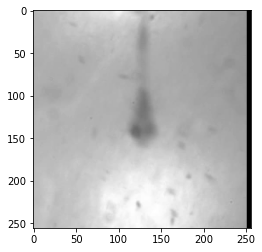

In [126]:
plt.imshow(frame,cmap='gray')

In [99]:
cd /Volumes/GoogleDrive/My Drive/PhD/Fishbase/TestStds


/Volumes/GoogleDrive/My Drive/PhD/Fishbase/TestStds


In [104]:
frame.var()

0.029565744

Move clips without blacklines to the appropriate directory:

In [169]:
directory='/Volumes/GoogleDrive/My Drive/PhD/Fishbase/BlackLines'
for i,samp in enumerate(ds):
    #vid = samp['clip']
    vidpath = ds.file_paths[i]
    vidbasename = os.path.basename(vidpath)
    dirname = f'{os.path.basename(os.path.dirname(vidpath))}_blacklines'
    #frame= get_plottable_frame(vid[:,0,:,:])
    cond1 = not frame[0:2,:].any()
    cond2 = not frame[-2:-1:,:].any()
    cond3  = not frame[:,0:2].any()
    cond4 = not frame[:,-2:-1].any()
    if  cond1 or cond2 or cond3 or cond4:
        #cv2.imwrite(f'{i}.jpg',frame*255)
        shutil.move(vidpath, os.path.join(directory,dirname,vidbasename))

## Move to the second part with the creation of the df:

In [2]:
column_names = ['samp_id','category', 'avg_error', 'var_error', 'max_error','original_samp', 'reconstruction', 'heat_map']
df = pd.DataFrame({column : [] for column in column_names})
df.head()

,samp_id,category,avg_error,var_error,max_error,original_samp,reconstruction,heat_map


Create the dataset and loader:

In [3]:
directory = 'G:/My Drive/PhD/Fishbase/SwimVSFeed/New_DB/photos/new'#'/Volumes/GoogleDrive/My Drive/PhD/Fishbase/SwimVSFeed/Feed/Success/_cut'#
ds=VideoDataset(directory,num_frames=100,
                transform=transforms.Compose([Rescale(256),ToTensor()]),match_hists=False,color_channels=1)
dataloader = DataLoader(ds, batch_size=1,
                        shuffle=False, num_workers=4)
len(ds)

2605

Load the model:

In [28]:
path = 'G:/My Drive/PhD/Fishbase/SwimVSFeed/New_DB/models/ds_fish2_histmatch/histmatch_autoencoder_140221_epoch299.pt'
checkpoint=torch.load(path,map_location=torch.device('cpu'))
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = Net(color_channels=1)
#model.to(device)
model.load_state_dict(checkpoint['model_state_dict'])

<All keys matched successfully>

Now let's get the model ready for prediction:

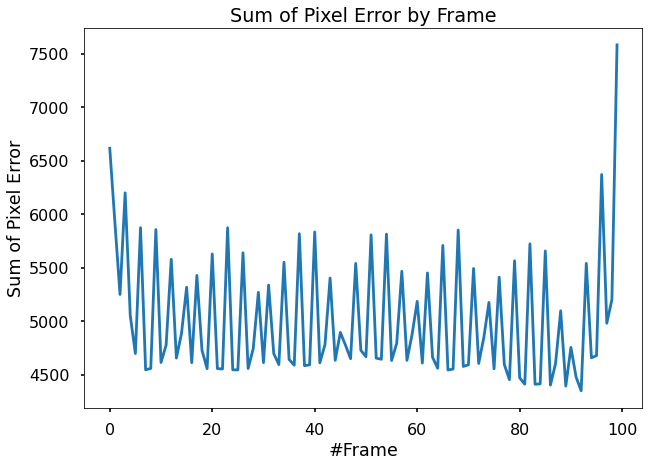

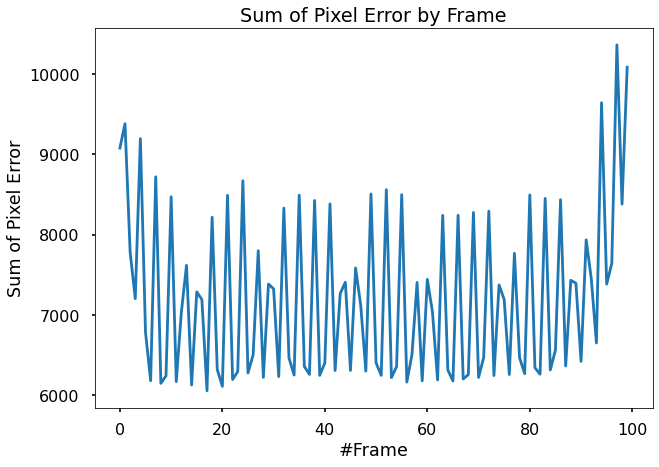

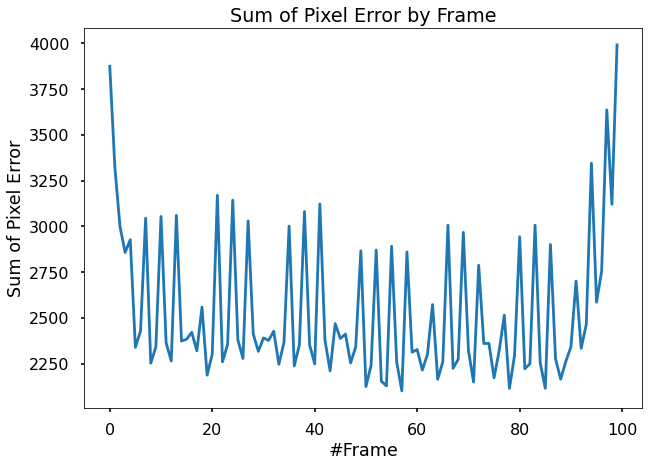

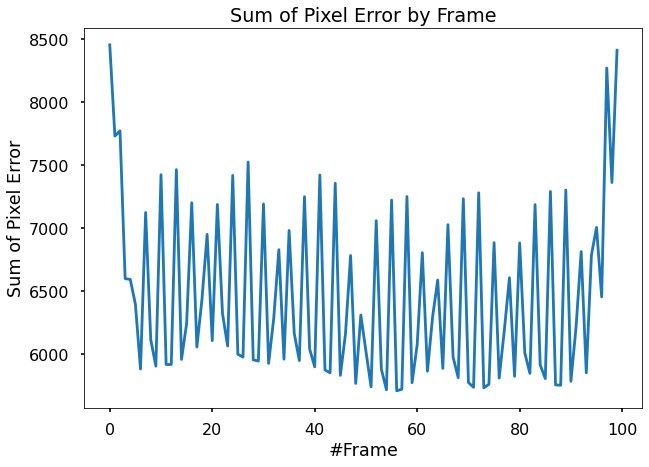

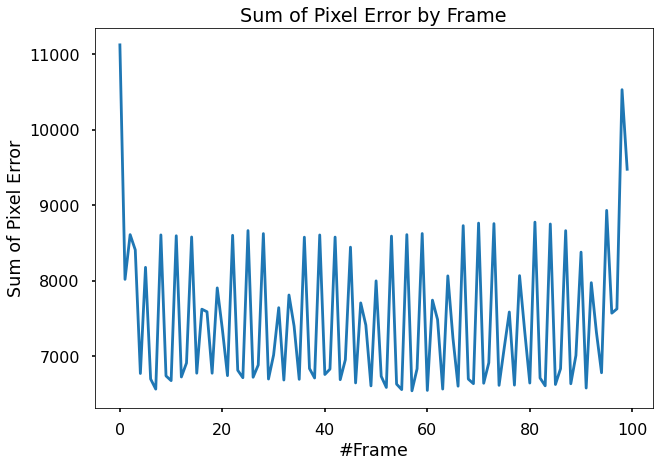

...

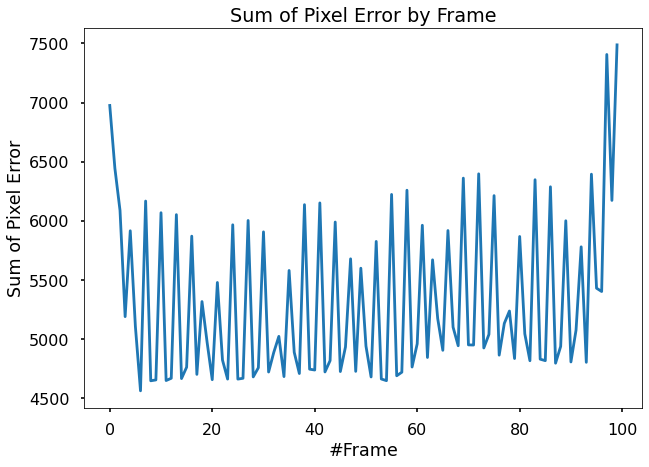

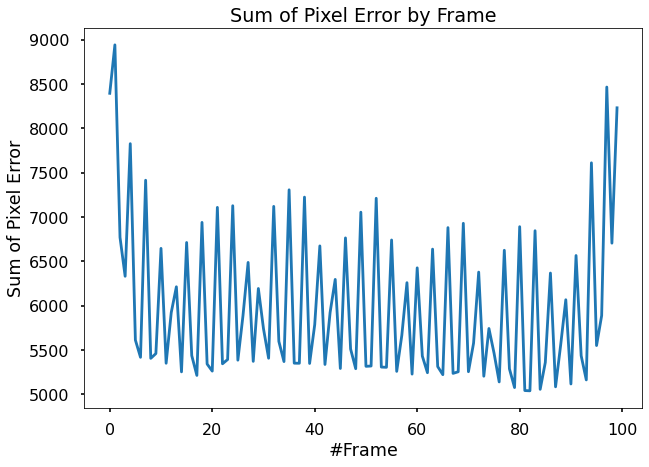

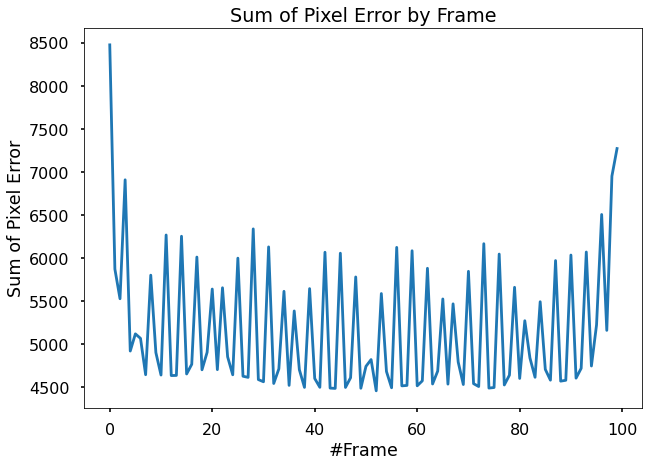

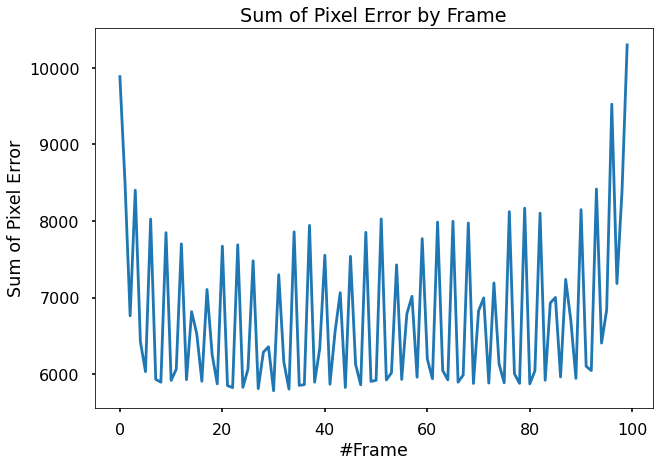

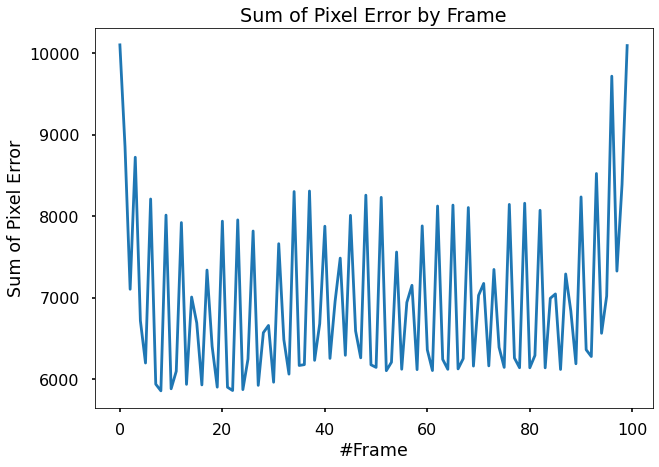

In [30]:
directory='G:/My Drive/PhD/Fishbase/SwimVSFeed/New_DB/Recon/ds_large2/'
column_names = ['samp_id','category', 'avg_error', 'var_error', 'max_error','original_samp','heat_map','reconstruction']
df = pd.DataFrame({column : [] for column in column_names})
model.eval() # put the model in evaluation mode
with torch.no_grad():
    for i,batch in enumerate(dataloader):
        clip = batch['clip']
        
        prediction = model(clip)
        vidpath = ds.file_paths[i]
        vidname = os.path.basename(vidpath)
        category = 'test_diffday'
        error = np.sqrt((prediction - clip)**2)
        #clip = np.squeeze(clip)
        #prediction = np.squeeze(prediction)
        if clip.shape[1]==2:
            #clip = np.transpose(prediction, (0,2,3,4,1))
            tmp = np.ones((1,3,clip.shape[2],clip.shape[3],clip.shape[4]))*0.5
            tmp[:,:-1,:,:,:] = clip
            clip = tmp.copy()

            #prediction = np.transpose(prediction, (0,2,3,4,1))
            tmp = np.ones((1,3,clip.shape[2],clip.shape[3],clip.shape[4]))*0.5
            tmp[:,:-1,:,:,:] = prediction
            prediction = tmp.copy()

        d = {'samp_id':vidname,'category':category, 'avg_error' : error.mean().item(), 
            'var_error':error.var().item(), 'max_error' : error.max().item(), 
             'heat_map': [],#os.path.join(directory,category,'heatmap_'+vidname),
             'reconstruction':[],#os.path.join(directory,category,vidname),
             'original_samp':[]}#vidpath}
        df=df.append(d, ignore_index=True)
        errorname = f"{''.join(vidname.split('.')[:-1])}.jpg"
        gifname = f"{''.join(vidname.split('.')[:-1])}.gif"
        error_by_frame(error,os.path.join(directory,'gifs',category,'sum_error_plots',errorname))
        write_gif_fish(clip,os.path.join(directory,'gifs',category,'original'),gifname)
        write_gif_fish(prediction,os.path.join(directory,'gifs',category),gifname)
        #write_gif_fish(error,os.path.join(directory,'gifs',category,'heatmaps'),'heatmap_'+gifname,heatmap=True)
        #write_movie(prediction,os.path.join(directory,category),vidname)
        #write_movie(error,os.path.join(directory,category,'heatmaps'),'heatmap_'+vidname,heatmap=True)
df.to_csv(os.path.join(directory,f'errors{category}.csv'))

(tensor([ 1393.3436,   787.6896,   653.8607,   614.4040,   433.7786,   662.9479,
           623.7473,   409.1375,   625.4171,   613.5840,   393.1957,   326.6019,
           435.1869,   345.8069,   285.1010,   475.7417,   919.6205,   683.9489,
           304.9848,  1007.4161,   712.0792,   540.6992,  1305.6979,   989.1984,
           392.5400,   926.4229,   789.5432,   479.5952,  1122.4760,   665.5362,
           340.6292,   461.8557,   489.6842,   595.5250,   932.7346,   517.2100,
           904.1011,   596.3647,   334.7482,   872.9817,   678.3111,   394.5292,
           784.1152,   797.0520,   355.1250,   757.1107,   608.7568,   309.3394,
           622.2618,   568.6483,   498.0955,   644.4312,   435.4183,   680.5494,
           668.6610,   549.6097,   680.8162,   554.9082,   321.2209,   545.0245,
           554.1737,   285.8666,   507.7911,   706.1580,   304.9729,   700.5859,
           602.2242,   435.1618,   705.7494,   443.5737,   507.8713,   276.3311,
           374.8524,   792.3

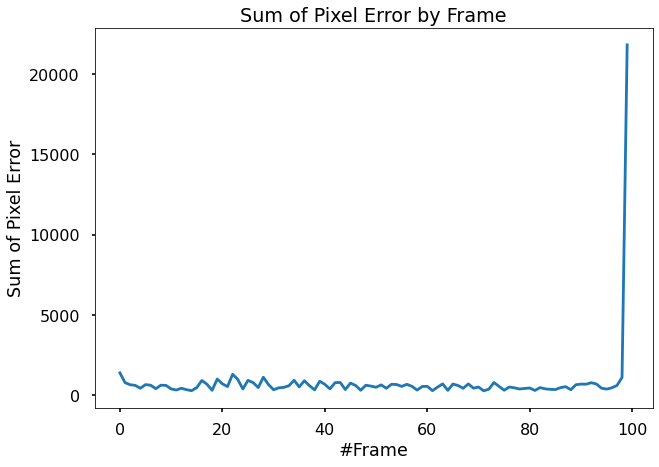

In [70]:
error_by_frame(error)

In [5]:
def error_by_frame(error,savedir=''):
    sum_of_error = torch.squeeze(error)

    if sum_of_error.shape[0]==2:
        sum_of_error = np.transpose(sum_of_error,(1,2,3,0))
        sum_of_error = sum_of_error.sum(axis=1).sum(axis=1).sum(axis=1)

    else:
        sum_of_error = sum_of_error.sum(axis=1).sum(axis=1)
        
    with plt.style.context('seaborn-poster'):
        fig = plt.figure(figsize=(10,7))
        plt.plot(range(len(sum_of_error)),sum_of_error)
        plt.xlabel('#Frame')
        plt.ylabel('Sum of Pixel Error')
        plt.title('Sum of Pixel Error by Frame')
        if len(savedir)>0:
            plt.savefig(savedir)
        #plt.close(fig)
    return sum_of_error,fig


In [9]:
def transform_clip(transform,clip):
    clip_transformed = torch.stack([transform(img) for img in clip])
    clip_transformed = torch.unsqueeze(clip_transformed,dim=0)
    clip_transformed = torch.unsqueeze(clip_transformed,dim=0)
    return clip_transformed

def get_transformed_clips(clip):
    flip_lr=transforms.RandomHorizontalFlip(p=1)
    flip_ud=transforms.RandomVerticalFlip(p=1)
    flip_both = transforms.Compose([flip_lr,flip_ud])
    clip = torch.squeeze(sample['clip'])
    clip_flip_both = transform_clip(flip_both,clip)
    clip_flip_lr = transform_clip(flip_lr,clip)
    clip_flip_ud = transform_clip(flip_ud,clip)
    return clip_flip_both, clip_flip_lr, clip_flip_ud
    
    


In [284]:
# New predictions: transform each image by fliping it vertically/horizontally to neutrlize the effect of swimming direction:
directory='/Volumes/GoogleDrive/My Drive/PhD/Fishbase/SwimVSFeed/Flipped_Recon/Swim/'
column_names = ['samp_id','category', 'avg_error', 'var_error', 'max_error','original_samp','heat_map','reconstruction', 'flipped']
df = pd.DataFrame({column : [] for column in column_names})
model.eval() # put the model in evaluation mode
with torch.no_grad():
    for i,batch in enumerate(dataloader):
        clip = batch['clip'].to(device)
        clip_both, clip_lr, clip_ud = get_transformed_clips(clip) #get clips that have been flipped in all directions
        predictions = {clip: model(clip), clip_both:model(clip_both),clip_lr:model(clip_lr), clip_ud:model(clip_ud)}
        errors = {key : np.sqrt((value - key)**2) for key,value in predictions.items()}
        avg_errors = {key : value.mean().item() for key,value in errors.items()}
        winner = min(avg_errors, key=avg_errors.get)
        error = errors[winner]
        vidpath = ds.file_paths[i]
        vidname = os.path.basename(vidpath)
        if (winner==clip).all():
            flipped = False
        else:
            flipped = True
        category = 'same orientation'
        #error = np.sqrt((prediction - clip)**2)
        d = {'samp_id':vidname,'category':category, 'avg_error' : error.mean().item(), 
            'var_error':error.var().item(), 'max_error' : error.max().item(), 
             'heat_map': [],#os.path.join(directory,category,'heatmap_'+vidname),
             'reconstruction':[],#os.path.join(directory,category,vidname),
             'original_samp':[], 
             'flipped':flipped}#vidpath}
        df=df.append(d, ignore_index=True)
        gifname = f"{vidname.split('.')[0]}.gif"
        write_gif_fish(clip,os.path.join(directory,'gifs',category,'original'),gifname)
        write_gif_fish(prediction,os.path.join(directory,'gifs',category),gifname)
        write_gif_fish(error,os.path.join(directory,'gifs',category,'heatmaps'),'heatmap_'+gifname,heatmap=True)
        #write_movie(predictions[winner],os.path.join(directory,category),vidname)
        #write_movie(error,os.path.join(directory,category,'heatmaps'),'heatmap_'+vidname,heatmap=True)
df.to_csv(os.path.join(directory,'errorsswim2_flipped.csv'))

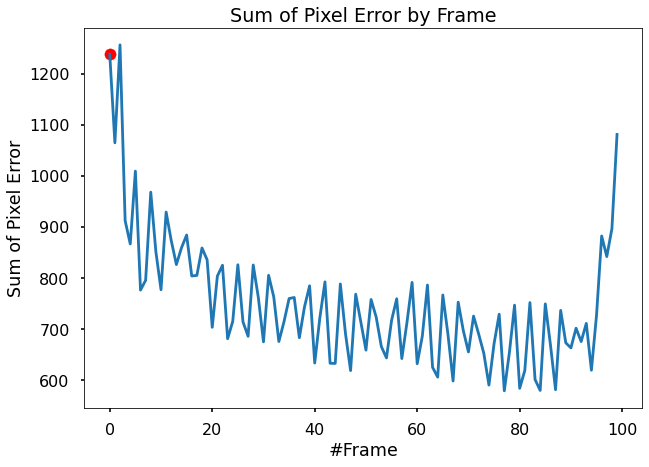

In [167]:
un=torch.dstack([torch.squeeze(clip),torch.squeeze(prediction)])
sum_of_error,fig3 = error_by_frame(error)
plt.scatter(0,sum_of_error[0],color='r')
omg = fig_to_img(fig3)

In [7]:
def new_error_movie(clip,pred,error):
    united = torch.dstack([torch.squeeze(clip),torch.squeeze(prediction)])
    sum_of_error,fig = error_by_frame(error)
    
    
    fig, ax= plt.subplots()
    myaximage = ax.imshow(im, aspect='auto', extent=(1200,2000,0.15,0.35), alpha=1, zorder=-1)
    ax.plot(list(adam_no_wdc_losses.keys()),list(adam_no_wdc_losses.values()),zorder=-1)
    ax.text(0.70, 0.45, 'reconstruction', transform=ax.transAxes, fontsize=12,
        verticalalignment='top')
    plt.scatter(epoch,adam_no_wdc_losses[epoch],color='r')
    #ax.grid()
    plt.xlabel('epoch')
    plt.ylabel('loss')
    plt.title('Fish Video - Loss: L2, Learning Rate: 1e-3, No Weight Decay')
    im3=fig_to_img(fig)
    im3=cv2.resize(im3,(1280,800))
    im3 = cv2.cvtColor(im3,cv2.COLOR_BGR2RGB)
    plt.close()
    video_writer.write(im3)
#video_writer.release()

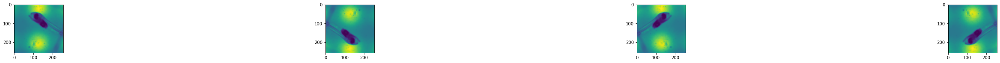

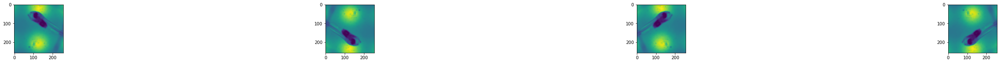

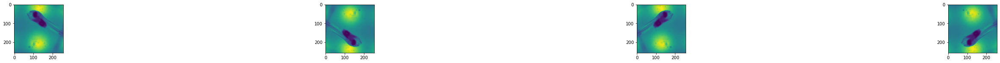

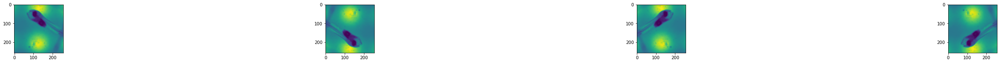

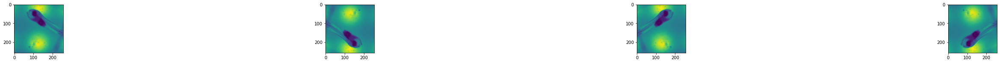

...

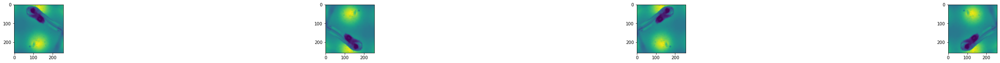

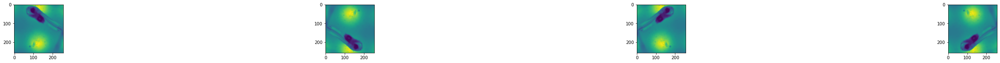

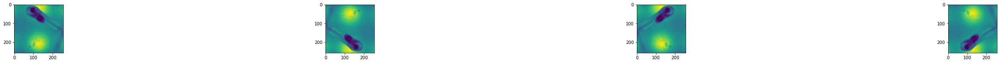

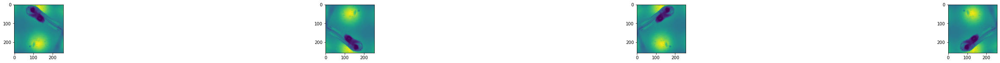

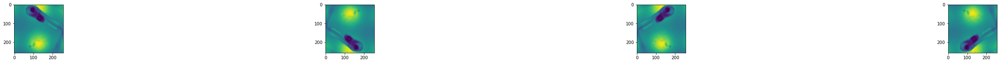

In [217]:
sample = ds[19]
clip = torch.squeeze(sample['clip'])
both = transforms.Compose([flip_lr,flip_ud])
clip_flip_lrud = torch.stack([both(img) for img in clip])
clip_flip_lr = torch.stack([flip_lr(img) for img in clip])
clip_flip_ud = torch.stack([flip_ud(img) for img in clip])
counter = 1
for i in range(clip_flip.shape[0]):
    plt.figure(figsize=(50,50))
    plt.subplot(20,4,counter)
    plt.imshow(clip[i,:,:])
    counter+=1
    plt.subplot(20,4,counter)
    plt.imshow(clip_flip_lrud[i,:,:])
    counter+=1
    plt.subplot(20,4,counter)
    plt.imshow(clip_flip_lr[i,:,:])
    counter+=1
    plt.subplot(20,4,counter)
    plt.imshow(clip_flip_ud[i,:,:])
    counter+=1

In [277]:
len(ds)

0

In [216]:
torch.unsqueeze(clip_flip,dim=0).shape

torch.Size([1, 20, 256, 256])

In [ ]:
model.eval()
with torch.no_grad():
    prediction = model(batch['clip'])

In [70]:
ite = (iter(dataloader))
next(ite)
batch=next(ite)

In [71]:
model.eval()
with torch.no_grad():
    prediction = model(batch['clip'])
np.transpose(np.squeeze(prediction), axes=[1,2,0]).shape


torch.Size([256, 256, 20])

In [8]:
def write_movie(recon,directory,samp_id, heatmap=False):
    fourcc=cv2.VideoWriter_fourcc(*'MJPG')
    if heatmap:
        size=(830,585)
    else:
        size=(256,256)
    video_writer=cv2.VideoWriter(os.path.join(directory,f'l1_recon_{samp_id}'),fourcc, 30, size, heatmap)
    for i in range(recon.shape[2]):
        frame = (get_plottable_frame(recon[0,:,i,:,:])*255).astype(np.uint8)
        if heatmap:
                fig = plt.figure()
                sns.heatmap(frame/255, vmin=0, vmax=1)
                plt.axis('off')
                frame = fig_to_img(fig)[65:650,120:950,:]
                plt.close(fig)
        video_writer.write(frame)
    video_writer.release()
        
        

In [8]:
def write_gif_fish(recon,directory,samp_id, heatmap=False):
    num_frames = recon.shape[2]
    if heatmap:
        size=(num_frames,585,830,3)
    elif recon.shape[1]>1:
        size=(num_frames,256,256,3)
    else:
        size=(num_frames,256,256,1)
    frames = np.zeros(size)
    for i in range(num_frames):
        frame = (get_plottable_frame(recon[0,:,i,:,:])*255).astype(np.uint8)
        if heatmap:
                fig = plt.figure()
                sns.heatmap(frame/255, vmin=0, vmax=1)
                plt.axis('off')
                frame = fig_to_img(fig)[65:650,120:950,:]
                plt.close(fig)
        elif frame.ndim==2:
            frame = frame[:,:,np.newaxis]
        frames[i,:,:,:] = frame
    clip = ImageSequenceClip(list(frames), fps=20)    
    clip.write_gif(os.path.join(directory,f'l1_recon_{samp_id}'), fps=10, verbose=False, logger=None)
    #return clip


    

In [7]:
write_movie(error, directory, 'output.gif', True)

NameError: name 'error' is not defined

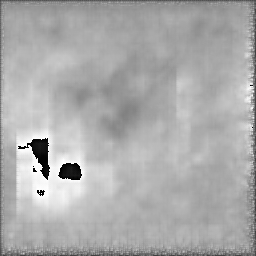

In [88]:
Image('/Volumes/GoogleDrive/My Drive/PhD/Fishbase/SwimVSFeed/Swim/l1_recon_output.gif')

In [112]:
frame=get_plottable_frame(np.sqrt(((prediction)-(batch['clip']))**2)[0,:,0,:,:])
frame2=get_plottable_frame((prediction)[0,:,0,:,:])
frame3 = get_plottable_frame((batch['clip'])[0,:,0,:,:])

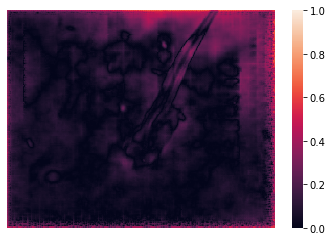

In [113]:
fig = plt.figure()
sns.heatmap(frame, vmin=0, vmax=1)
plt.axis('off')
frame = fig_to_img(fig)


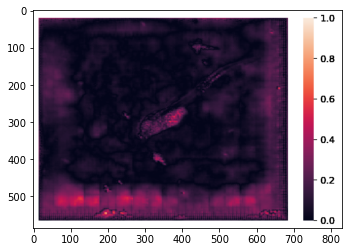

In [71]:
plt.imshow(frame[65:650,120:950,:])

In [13]:
error=np.sqrt(((prediction)-(batch['clip']))**2)

In [54]:
batch['clip'].to(device)

NameError: name 'batch' is not defined

In [33]:
write_movie(error,directory,'heat_map'+'test.avi',heatmap=True)


In [87]:
np.squeeze(error).max().item()

1.1630839109420776

In [11]:
heat_video(batch['clip'], prediction, directory,'test',batch_size=1)

20
/Volumes/GoogleDrive/My Drive/PhD/Fishbase/SwimVSFeed/Swimheatmap_test.avi


In [18]:
cd /Volumes/GoogleDrive/My Drive/PhD/Fishbase/SwimVSFeed


/Volumes/GoogleDrive/My Drive/PhD/Fishbase/SwimVSFeed


In [24]:
SCOPES = ('https://www.googleapis.com/auth/drive.readonly','https://www.googleapis.com/auth/spreadsheets')
store = file.Storage('storage.json')
creds = store.get()
if not creds or creds.invalid:
    flow = client.flow_from_clientsecrets('client_secret.json', SCOPES)
    creds = tools.run_flow(flow, store)
HTTP = creds.authorize(Http())
DRIVE = discovery.build('drive',   'v3', http=HTTP)
SHEETS = discovery.build('sheets',  'v4', http=HTTP)

In [79]:
#diff_heatmaps_folder = '1rDMySRy4yXAF7iT9JDOIQOCE-g8YSZeH'
#diff_recon_folder = '1qX3cFSddzV4tkl0gs8s8i5TkNLpuy6_L'
#same_recon_folder = '1qeyOYcU4tIqzp4Ox1y34nLj2uxDrgPW5'
#same_heatmaps_folder = '1r86UZ6Rkmc7j9-LMQW8zSZY8YbRlGEeN'
#original_folder = '1qks_0mnsc_kmVKR1VXvFJ5GoJTGJwrVD'
feed_recon_folder = '1lZlqUtxYYJUNfKXEzJKSgQq4OumM9n98'
feed_heatmaps_folder = '1ldS5XlYVn4GgP-z1w_J-uPlb4XB87DlE'
feed_original_folder = '1GBsjUrbBKCcXPDaA-XdAx36ROrjXvuRe'
mime_type = 'image/gif'
#diff_files = DRIVE.files().list(q=f"mimeType='{mime_type}' and ( '{diff_heatmaps_folder}' in parents)" ,
#            fields='files(id,name,mimeType,webViewLink,parents)').execute().get('files', [])
#same_files = DRIVE.files().list(q=f"mimeType='{mime_type}' and ( '{same_heatmaps_folder}' in parents)" ,
#            fields='files(id,name,mimeType,webViewLink,parents)').execute().get('files', [])
feed_heatmaps_files = DRIVE.files().list(q=f"mimeType='{mime_type}' and ( '{feed_heatmaps_folder}' in parents)" ,pageSize = 1000,
            fields='nextPageToken,files(id,name,mimeType,webViewLink,parents)').execute().get('files', [])

In [80]:
files=pd.DataFrame(feed_heatmaps_files)
#files=files.append(diff_files)

In [54]:
#df = pd.read_csv('Recon/errors.csv')

In [83]:
files

,id,name,mimeType,parents,webViewLink,samp_id
0,1Qu01PdUIBrDxtBCIhriFERlm_trXlXem,l1_recon_heatmap_cutout_299467-300834_5_segmen...,image/gif,[1ldS5XlYVn4GgP-z1w_J-uPlb4XB87DlE],https://drive.google.com/file/d/1Qu01PdUIBrDxt...,cutout_299467-300834_5_segment_5.avi
1,1QpNATbnAYezIsmM_N4OkB9or5YxbhIbW,l1_recon_heatmap_cutout_299467-300834_5_segmen...,image/gif,[1ldS5XlYVn4GgP-z1w_J-uPlb4XB87DlE],https://drive.google.com/file/d/1QpNATbnAYezIs...,cutout_299467-300834_5_segment_4.avi
2,1QZaO27QFNxlgb-A5MWsvbB5iRzQ2xk1Q,l1_recon_heatmap_cutout_299467-300834_5_segmen...,image/gif,[1ldS5XlYVn4GgP-z1w_J-uPlb4XB87DlE],https://drive.google.com/file/d/1QZaO27QFNxlgb...,cutout_299467-300834_5_segment_3.avi
3,1Q7MwXthdxkSMFfKMMuoJqE6jGwFOJTjt,l1_recon_heatmap_cutout_299467-300834_5_segmen...,image/gif,[1ldS5XlYVn4GgP-z1w_J-uPlb4XB87DlE],https://drive.google.com/file/d/1Q7MwXthdxkSMF...,cutout_299467-300834_5_segment_2.avi
4,1Pxf0TrgPHEsNoA1QtI9iu3q3fpU3Ts1z,l1_recon_heatmap_cutout_299467-300834_5_segmen...,image/gif,[1ldS5XlYVn4GgP-z1w_J-uPlb4XB87DlE],https://drive.google.com/file/d/1Pxf0TrgPHEsNo...,cutout_299467-300834_5_segment_1.avi
...,...,...,...,...,...,...
233,1HoV4I9Q0Qh48cpbTc9UL-lu7o5xmtfhm,l1_recon_heatmap_405044-407510 (7)_segment_5.gif,image/gif,[1ldS5XlYVn4GgP-z1w_J-uPlb4XB87DlE],https://drive.google.com/file/d/1HoV4I9Q0Qh48c...,405044-407510 (7)_segment_5.avi
234,1Ha1sJIp8a5_Cioc1pDlE2WEV-wYu0DXv,l1_recon_heatmap_405044-407510 (7)_segment_4.gif,image/gif,[1ldS5XlYVn4GgP-z1w_J-uPlb4XB87DlE],https://drive.google.com/file/d/1Ha1sJIp8a5_Ci...,405044-407510 (7)_segment_4.avi
235,1HNSAzRdRIdYW9a8Dxy-NURNh9hWr0HuP,l1_recon_heatmap_405044-407510 (7)_segment_3.gif,image/gif,[1ldS5XlYVn4GgP-z1w_J-uPlb4XB87DlE],https://drive.google.com/file/d/1HNSAzRdRIdYW9...,405044-407510 (7)_segment_3.avi
236,1GsyUPokqswEggS1U2v6zQjQic-tXcZab,l1_recon_heatmap_405044-407510 (7)_segment_2.gif,image/gif,[1ldS5XlYVn4GgP-z1w_J-uPlb4XB87DlE],https://drive.google.com/file/d/1GsyUPokqswEgg...,405044-407510 (7)_segment_2.avi


In [82]:
files['samp_id']=files['name'].apply(lambda x: f"{'_'.join(x.split('.')[0].split('_')[3:])}.avi") #heatmap
#files['samp_id']=files['name'].apply(lambda x: f"{'_'.join(x.split('.')[0].split('_')[2:])}.avi") #recon

In [44]:
def assign_links(files,samp_id):
    print(samp_id)
    link = files.loc[files['samp_id']==samp_id,'webViewLink'].item()
    print(link)
    return link

def make_clickable(url):
    return f'<a href="{url}" rel="noopener noreferrer" target="_blank">{url}</a>'

In [84]:
df['heat_map']=df['samp_id'].apply(lambda x: assign_links(files,x))

#df['original_samp'] = df.apply(lambda x: make_clickable(x['original_samp']), axis=1)


405044-407510 (7)_segment_1.avi
https://drive.google.com/file/d/1GR1k4ozVgPT2HfRCNV1z5CFQI3BzzbAu/view?usp=drivesdk
405044-407510 (7)_segment_2.avi
https://drive.google.com/file/d/1GsyUPokqswEggS1U2v6zQjQic-tXcZab/view?usp=drivesdk
405044-407510 (7)_segment_3.avi
https://drive.google.com/file/d/1HNSAzRdRIdYW9a8Dxy-NURNh9hWr0HuP/view?usp=drivesdk
405044-407510 (7)_segment_4.avi
https://drive.google.com/file/d/1Ha1sJIp8a5_Cioc1pDlE2WEV-wYu0DXv/view?usp=drivesdk
405044-407510 (7)_segment_5.avi
https://drive.google.com/file/d/1HoV4I9Q0Qh48cpbTc9UL-lu7o5xmtfhm/view?usp=drivesdk
1 (4)_segment_1.avi
https://drive.google.com/file/d/1Hzc2awusnpn6yYrUmlnkz6zraWTvljnb/view?usp=drivesdk
1 (4)_segment_2.avi
https://drive.google.com/file/d/1IXXJtaKZdN7TwLZSd45pcDCPB_PS2_MZ/view?usp=drivesdk
1 (4)_segment_3.avi
https://drive.google.com/file/d/1Ir39x-864rECZWEck5BYO8-_Pg4vUHS9/view?usp=drivesdk
1 (4)_segment_4.avi
https://drive.google.com/file/d/1JKwdeFAF8JSw69ZKynaopT4aYOecBF6X/view?usp=drivesdk
1 (4

In [72]:

df

,samp_id,category,avg_error,var_error,max_error,heat_map,original_samp,reconstruction
0,405044-407510 (7)_segment_1.avi,feed,0.227825,0.066012,2.880001,https://drive.google.com/file/d/1GIBLrvoftovVp...,https://drive.google.com/file/d/1GD98fNFLHvn1A...,https://drive.google.com/file/d/1GIBLrvoftovVp...
1,405044-407510 (7)_segment_2.avi,feed,0.227531,0.066350,2.641124,https://drive.google.com/file/d/1GWCGP05p6RQdX...,https://drive.google.com/file/d/1GmgD_sAMm0UUb...,https://drive.google.com/file/d/1GWCGP05p6RQdX...
2,405044-407510 (7)_segment_3.avi,feed,0.225657,0.064841,2.627492,https://drive.google.com/file/d/1GwkgSUJ0ssC7p...,https://drive.google.com/file/d/1H50mPga2Zoy7M...,https://drive.google.com/file/d/1GwkgSUJ0ssC7p...
3,405044-407510 (7)_segment_4.avi,feed,0.224241,0.065740,2.750502,https://drive.google.com/file/d/1HTneq7OxP6ZiV...,https://drive.google.com/file/d/1HQF44UWqrcluC...,https://drive.google.com/file/d/1HTneq7OxP6ZiV...
4,405044-407510 (7)_segment_5.avi,feed,0.225754,0.065066,2.669945,https://drive.google.com/file/d/1HgiclO6vwX77-...,https://drive.google.com/file/d/1HcBLj3Rx5rFyq...,https://drive.google.com/file/d/1HgiclO6vwX77-...
...,...,...,...,...,...,...,...,...
233,cutout_299467-300834_5_segment_1.avi,feed,0.137441,0.014215,1.462503,https://drive.google.com/file/d/1PVNhZ0uEN2i3q...,https://drive.google.com/file/d/1PisTGCcgMNwa9...,https://drive.google.com/file/d/1PVNhZ0uEN2i3q...
234,cutout_299467-300834_5_segment_2.avi,feed,0.136880,0.013660,1.006486,https://drive.google.com/file/d/1PpBG2u2pD0MF0...,https://drive.google.com/file/d/1PqUWL-Uyng6_W...,https://drive.google.com/file/d/1PpBG2u2pD0MF0...
235,cutout_299467-300834_5_segment_3.avi,feed,0.138447,0.014166,1.512897,https://drive.google.com/file/d/1Pzfhh2nGjfdSs...,https://drive.google.com/file/d/1Q31lJ6v0FVT0l...,https://drive.google.com/file/d/1Pzfhh2nGjfdSs...
236,cutout_299467-300834_5_segment_4.avi,feed,0.142673,0.016158,1.721562,https://drive.google.com/file/d/1QSAdJDgDIfIbR...,https://drive.google.com/file/d/1QZGXzoAPp661l...,https://drive.google.com/file/d/1QSAdJDgDIfIbR...


In [358]:
df.merge(files[['samp_id','webContentLink']],on='samp_id',how='left',suffixes=('diff_heat_map'))

,Unnamed: 0,samp_id,category,avg_error,var_error,max_error,heat_map,original_samp,reconstruction
0,0,cutoutframe_67230_coords_1388-918_fish0.avi,same orientation,0.091881,0.009164,0.677977,"<a href=""https://drive.google.com/file/d/16G0q...",[],"<a href=""https://drive.google.com/file/d/16DHB..."
1,1,cutoutframe_1410777_coords_1236-651_fish0.avi,same orientation,0.052654,0.002320,0.546362,"<a href=""https://drive.google.com/file/d/16Rdp...",[],"<a href=""https://drive.google.com/file/d/16IeG..."
2,2,cutoutframe_1366956_coords_456-316_fish0.avi,same orientation,0.054449,0.003038,0.758444,"<a href=""https://drive.google.com/file/d/16WrS...",[],"<a href=""https://drive.google.com/file/d/16Tp7..."
3,3,cutoutframe_1244970_coords_597-806_fish0.avi,same orientation,0.046508,0.001860,0.586839,"<a href=""https://drive.google.com/file/d/16seX...",[],"<a href=""https://drive.google.com/file/d/16Zr_..."
4,4,cutoutframe_1244565_coords_878-233_fish0.avi,same orientation,0.063299,0.003731,1.262865,"<a href=""https://drive.google.com/file/d/17-L8...",[],"<a href=""https://drive.google.com/file/d/16tGj..."
...,...,...,...,...,...,...,...,...,...
98,98,cutout_frame622080fish0.avi,different,0.098603,0.010107,0.864676,"<a href=""https://drive.google.com/file/d/1Pqw2...",[],"<a href=""https://drive.google.com/file/d/1PkHw..."
99,99,cutout_frame442341fish0.avi,different,0.150965,0.021814,1.936784,"<a href=""https://drive.google.com/file/d/1Q-xR...",[],"<a href=""https://drive.google.com/file/d/1PyOm..."
100,100,cutout_frame262035fish0.avi,different,0.090621,0.006647,0.776598,"<a href=""https://drive.google.com/file/d/1Q9bo...",[],"<a href=""https://drive.google.com/file/d/1Q1_3..."
101,101,cutout_frame262116fish0.avi,different,0.104383,0.006525,0.899736,"<a href=""https://drive.google.com/file/d/1QEcd...",[],"<a href=""https://drive.google.com/file/d/1Q9e7..."


In [399]:
df.drop('Unnamed: 0',axis=1)

,samp_id,category,avg_error,var_error,max_error,heat_map,original_samp,reconstruction
0,cutoutframe_67230_coords_1388-918_fish0.avi,same orientation,0.091881,0.009164,0.677977,"<a href=""https://drive.google.com/file/d/16G0q...","<a href=""https://drive.google.com/file/d/169JY...","<a href=""https://drive.google.com/file/d/16DHB..."
1,cutoutframe_1410777_coords_1236-651_fish0.avi,same orientation,0.052654,0.002320,0.546362,"<a href=""https://drive.google.com/file/d/16Rdp...","<a href=""https://drive.google.com/file/d/16KmV...","<a href=""https://drive.google.com/file/d/16IeG..."
2,cutoutframe_1366956_coords_456-316_fish0.avi,same orientation,0.054449,0.003038,0.758444,"<a href=""https://drive.google.com/file/d/16WrS...","<a href=""https://drive.google.com/file/d/16WYW...","<a href=""https://drive.google.com/file/d/16Tp7..."
3,cutoutframe_1244970_coords_597-806_fish0.avi,same orientation,0.046508,0.001860,0.586839,"<a href=""https://drive.google.com/file/d/16seX...","<a href=""https://drive.google.com/file/d/16eY2...","<a href=""https://drive.google.com/file/d/16Zr_..."
4,cutoutframe_1244565_coords_878-233_fish0.avi,same orientation,0.063299,0.003731,1.262865,"<a href=""https://drive.google.com/file/d/17-L8...","<a href=""https://drive.google.com/file/d/16zl_...","<a href=""https://drive.google.com/file/d/16tGj..."
...,...,...,...,...,...,...,...,...
98,cutout_frame622080fish0.avi,different,0.098603,0.010107,0.864676,"<a href=""https://drive.google.com/file/d/1Pqw2...","<a href=""https://drive.google.com/file/d/1P_-h...","<a href=""https://drive.google.com/file/d/1PkHw..."
99,cutout_frame442341fish0.avi,different,0.150965,0.021814,1.936784,"<a href=""https://drive.google.com/file/d/1Q-xR...","<a href=""https://drive.google.com/file/d/1Q-gr...","<a href=""https://drive.google.com/file/d/1PyOm..."
100,cutout_frame262035fish0.avi,different,0.090621,0.006647,0.776598,"<a href=""https://drive.google.com/file/d/1Q9bo...","<a href=""https://drive.google.com/file/d/1Q5E0...","<a href=""https://drive.google.com/file/d/1Q1_3..."
101,cutout_frame262116fish0.avi,different,0.104383,0.006525,0.899736,"<a href=""https://drive.google.com/file/d/1QEcd...","<a href=""https://drive.google.com/file/d/1Q5hA...","<a href=""https://drive.google.com/file/d/1Q9e7..."


In [388]:
sum(files['samp_id']=='cutoutframe_67230_coords_1388-918_fish0.avi')


1

In [43]:
df

,samp_id,category,avg_error,var_error,max_error,heat_map,original_samp,reconstruction
0,405044-407510 (7)_segment_1.avi,feed,0.227825,0.066012,2.880001,[],[],[]
1,405044-407510 (7)_segment_2.avi,feed,0.227531,0.066350,2.641124,[],[],[]
2,405044-407510 (7)_segment_3.avi,feed,0.225657,0.064841,2.627492,[],[],[]
3,405044-407510 (7)_segment_4.avi,feed,0.224241,0.065740,2.750502,[],[],[]
4,405044-407510 (7)_segment_5.avi,feed,0.225754,0.065066,2.669945,[],[],[]
...,...,...,...,...,...,...,...,...
233,cutout_299467-300834_5_segment_1.avi,feed,0.137441,0.014215,1.462503,[],[],[]
234,cutout_299467-300834_5_segment_2.avi,feed,0.136880,0.013660,1.006486,[],[],[]
235,cutout_299467-300834_5_segment_3.avi,feed,0.138447,0.014166,1.512897,[],[],[]
236,cutout_299467-300834_5_segment_4.avi,feed,0.142673,0.016158,1.721562,[],[],[]


In [85]:
df.to_csv('Recon/errorsfeed.csv')

In [766]:
cap = cv2.VideoCapture('/Volumes/GoogleDrive/My Drive/PhD/Fishbase/SwimVSFeed/Feed/Success/Camera 2 - frames 299467-300834.avi')



In [767]:

for i in range(300):
    ret,frame = cap.read()

(800, 800, 3)

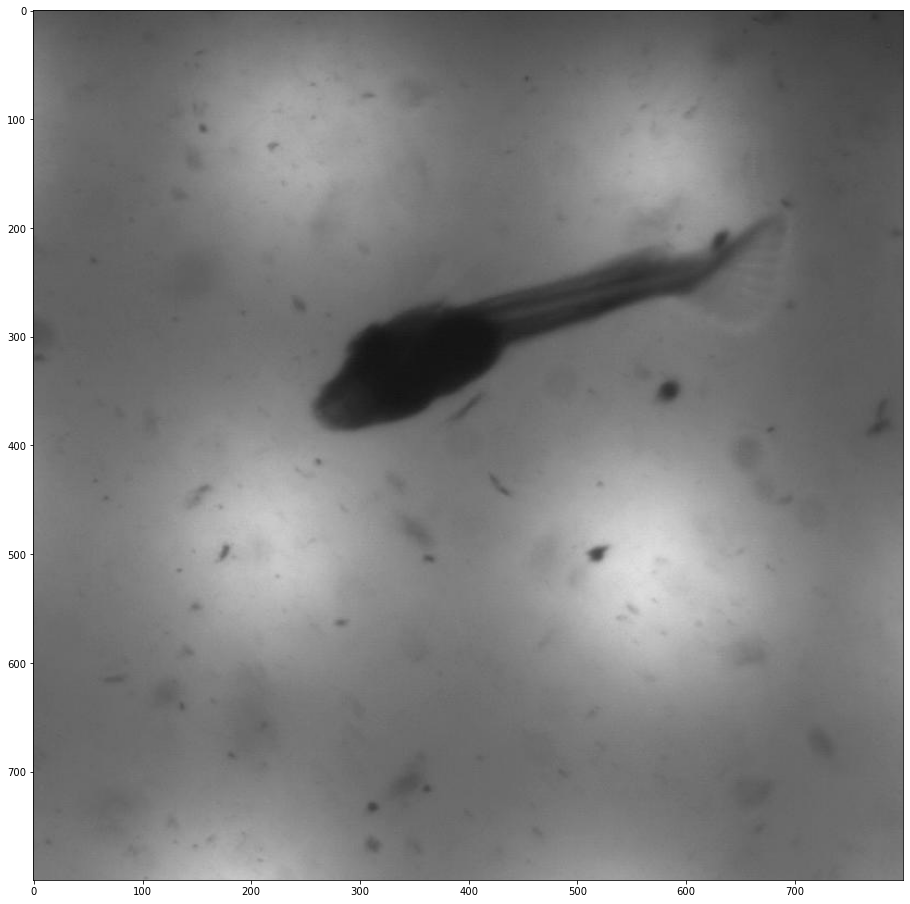

In [735]:
ret,frame = cap.read()
plt.figure(figsize=(16,16))
plt.imshow(frame[50:850,100:900])#[280:1080,200:1000])#[200:1000,300:1100])#[0:800,1120:1920])#[200:1000,850:1650])
frame[0:800,1000:1800].shape

In [768]:
# directory ='/Volumes/GoogleDrive/My Drive/PhD/Fishbase/SwimVSFeed/Feed/Success/'
fourcc = cv2.VideoWriter_fourcc(*'MJPG')
video_writer = cv2.VideoWriter(os.path.join(directory,f'cutout_299467-300834_3.avi'),fourcc, 30, (800,800), True)
for i in range(100):
    ret,frame = cap.read()
    if ret:
        video_writer.write(frame[50:850,100:900])
    else:
        break
video_writer.release()

In [430]:
750+400

1150

In [739]:
cap.get(cv2.CAP_PROP_FRAME_COUNT)

1368.0

In [9]:
def split_clip(load_path,save_path,num_frames,fps=30):
    cap=cv2.VideoCapture(load_path)
    fourcc=cv2.VideoWriter_fourcc(*"MJPG")
    W = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    H = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    counter=1
    cont=True
    while cont:
        movie_path = save_path + os.path.basename(load_path).split('.')[0] +\
                 '_segment_' + str(counter) + '.avi'
        vid_writer=cv2.VideoWriter(movie_path, fourcc, fps, (H,W),True)
        for i in range(num_frames):
            ret,frame = cap.read()
            if ret:
                vid_writer.write(np.uint8(frame))
            else:
                cont=False
                break
        vid_writer.release()
        if i<num_frames-1:
            os.remove(movie_path)
        counter+=1


In [10]:
for root, directories, files in os.walk('/Volumes/GoogleDrive/My Drive/PhD/Fishbase/SwimVSFeed/Feed/Success/'):
    for filename in files:
        if filename.endswith('.avi'):
            filepath=os.path.join(root,filename)
            savepath=root+'_cut/'
            if not os.path.exists(savepath):
                os.mkdir(savepath)
            split_clip(filepath,savepath,20)

In [35]:
feed_df = pd.read_csv('G:/My Drive/PhD/Fishbase/SwimVSFeed/New_DB/Recon/ds_fish2_histmatch/errorsfeed_light.csv')#'/Volumes/GoogleDrive/My Drive/PhD/Fishbase/SwimVSFeed/Flipped_Recon/errorfeed_flipped.csv')
test_df = pd.read_csv('G:/My Drive/PhD/Fishbase/SwimVSFeed/New_DB/Recon/ds_fish2_histmatch/errorstest.csv')
test_diff_df = pd.read_csv('G:/My Drive/PhD/Fishbase/SwimVSFeed/New_DB/Recon/ds_fish2_histmatch/errorstest_diffday.csv')
len(feed_df),len(test_df),len(test_diff_df)

(27, 34, 268)

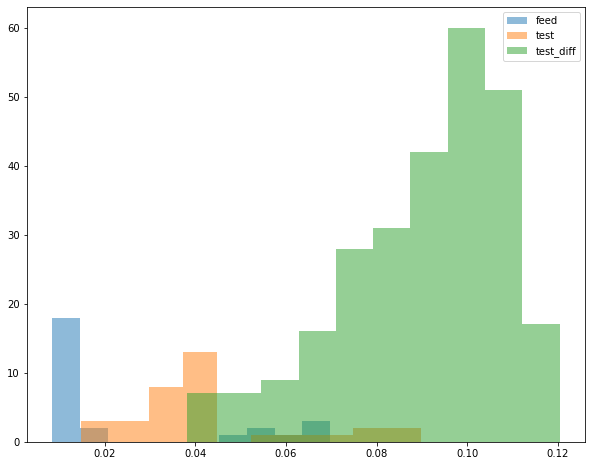

In [37]:
plt.figure(figsize=(10,8))
plt.hist(feed_df.avg_error,bins=10,alpha=0.5,label='feed')
plt.hist(test_df.avg_error,bins=10,alpha=0.5,label='test')
plt.hist(test_diff_df.avg_error,bins=10,alpha=0.5,label='test_diff')
plt.legend()
plt.savefig('G:/My Drive/PhD/Fishbase/SwimVSFeed/New_DB/Recon/ds_fish2_histmatch/error_dist.png')

In [17]:
def roc_curve(errors,labels,directory):
    # a label of 1 is anomaly, a label of 0 is normal, 
    # errors are the average reconstruction error for each sample, they'll be our normality score for now
    max_error = max(errors) # get max error
    tpr = np.zeros(len(errors))
    fpr = np.zeros(len(errors))
    precision = np.zeros(len(errors))
    threshes = np.zeros(len(errors))
    for i,thres in enumerate(np.linspace(0,max_error,len(errors))):
        # iterate over the space of possible thresholds
        new_labels = errors>thres # get the new labels
        tp = sum((new_labels+labels)==2)
        fn = new_labels[(new_labels != labels) & (new_labels==0)].size
        fp = new_labels[(new_labels != labels) & (new_labels==1)].size
        tn = sum((new_labels+labels)==0)
        precision[i] = tp/(tp+fp)
        # Recall = tpr
        tpr[i] = tp/(tp+fn)
        fpr[i] = fp/(fp+tn)
        threshes[i] = thres
    auc_score = auc(fpr,tpr)
    plt.figure(figsize=(15,5))
    plt.subplot(1,2,1)
    plt.plot(fpr,tpr)
    plt.ylabel('tpr')
    plt.xlabel('fpr')
    plt.title('ROC Curve')
    plt.text(0.2,0.8,f'AUC score: {auc_score}')
    plt.savefig(os.path.join(directory,'ROC.jpg'),dpi=200)
    plt.subplot(1,2,2)
    plt.plot(tpr,precision)
    plt.ylabel('Recall')
    plt.xlabel('Precision')
    plt.title('Precision-Recall Curve')
    plt.savefig(os.path.join(directory,'ROC-PR.jpg'),dpi=200)
    
    return threshes, tpr, fpr, precision,auc_score
        

In [20]:

feed_error = feed_df['avg_error'].to_numpy()
swim_error = test_diff_df['avg_error'].to_numpy()
feed_labels = np.ones(len(feed_error))
swim_labels = np.zeros(len(swim_error))
labels = np.concatenate([feed_labels,swim_labels])
errors = np.concatenate([feed_error,swim_error])

AUC Score: 0.4869402985074626


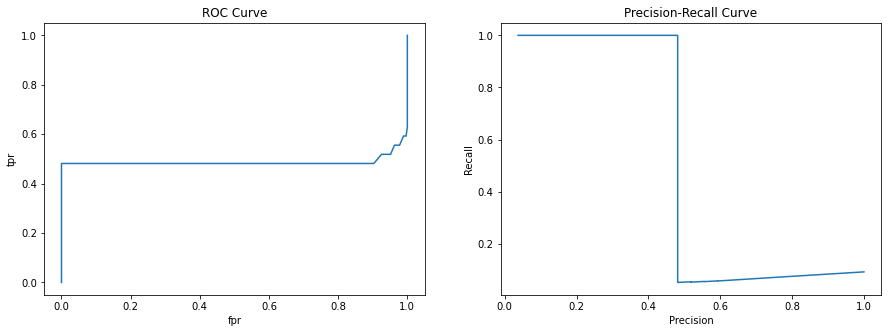

In [21]:
thresh, tpr, fpr,precision,auc_score = roc_curve(errors,labels,'G:/My Drive/PhD/Fishbase/SwimVSFeed/New_DB/Recon/ds_large2/')
#auc_score = auc(fpr,tpr)
print(f'AUC Score: {auc_score}')

In [309]:
# get the Precision and Recall by using the method mentioned by Bergman and Hoshen 2020, 
# they referenced Zong et al 2018
# The method states that you set the threshold for tagging the samples as the N highest scoring samples 
# (where higher is more anomalous) and N is the number of anomalous samples we fed the model.
zong_thres = len(feed_error)
#sorted_errors = sorted(errors)[::-1]
#flagged = sorted_errors[:zong_thres]
tmp_feed=pd.concat([feed_df['avg_error'],pd.Series(np.ones(len(feed_df)).astype(int),name='label')],axis=1)
tmp_swim=pd.concat([swim_df['avg_error'],pd.Series(np.zeros(len(swim_df)).astype(int),name='label')],axis=1)
err_df = pd.concat([tmp_feed,tmp_swim])
err_df = err_df.sort_values(by='avg_error',ascending=False)
flagged = err_df.iloc[:zong_thres] # these are all "labeled" as 1, meaning anomalous
counts=flagged.groupby('label').count()
print(counts)
tp = counts.iloc[1].item() # get the true positives, the samples that were correctly labeled
fp = counts.iloc[0].item() # get the false positives, the normal samples that were accidently identified as anomalous
fn = len(feed_df) - tp
precision = tp/(tp+fp)
recall = tp/(tp+fn) #same as precision in this case as fn necessarily equals fp
print(f'precision: {precision}')

       avg_error
label           
0             27
1            211
precision: 0.8865546218487395


In [ ]:
plt.figure(figsize=(15,8))
plt.hist(feed_error,alpha=0.5, label='feed')
plt.hist(swim_error,alpha=0.5, label='swim')
plt.legend(loc='upper right')


In [172]:
lb =  np.array([1,1,0,0,1,0,0,0])
nlb = np.array([1,0,1,0,1,0,1,1])
roc_curve([],lb,nlb)
lb+nlb

38

## Optic Flow:

#### Motivation
I'd like to learn how to calculate optic flow so that I can implement a two stream convolutional network, or even better - an I3D network, inflated two stream, due to Carreira and Zisserman (2018).
We're going to use the same TVL1 method they refer to in the paper. In the repository (https://github.com/deepmind/kinetics-i3d) they say they followed a similar implementation the OpenCV implementation so I'll use that.
I found the following code snippet on github and will follow a similar route: https://github.com/Rhythmblue/i3d_finetune/issues/2#issuecomment-396022851

In [20]:
directory = 'G:/My Drive/PhD/Fishbase/SwimVSFeed/New_DB/photos/train_fish2/800px'#'/Volumes/GoogleDrive/My Drive/PhD/Fishbase/SwimVSFeed/New_DB/photos/ds_fish2/'#'/Volumes/GoogleDrive/My Drive/PhD/Fishbase/SwimVSFeed/Feed/Success/_cut'#
ds=VideoDataset(directory,num_frames=200,
                transform=transforms.Compose([ToTensor()]),match_hists=True,div_255=False)
dataloader = DataLoader(ds, batch_size=1,
                        shuffle=False, num_workers=0)
len(ds)

59

In [19]:
os.path.basename(ds.file_paths[0])

'101219_cutoutframe_233289_coords_1880-254_fish0.avi'

In [21]:
def compute_TVL1(prev, curr, bound=20):
    """Compute the TV-L1 optical flow. Set it to between a 20 and -20 bound and scale down to 1 to -1, 
    following the description in https://github.com/deepmind/kinetics-i3d"""
    TVL1 = cv2.optflow.DualTVL1OpticalFlow_create()
    flow = TVL1.calc(prev, curr, None)
    flow[flow<-bound] = -bound
    flow[flow>bound] = bound
    flow = flow/bound
    return flow

In [25]:
def calc_flow(ds,data_iter,save_dir):
    for i, data in enumerate(data_iter,0):
        filename= 'flow_'+os.path.basename(ds.file_paths[i])
        clip = np.squeeze(data['clip']).numpy().astype(np.uint8)
        fourcc=cv2.VideoWriter_fourcc(*'MJPG')
        video_writer=cv2.VideoWriter(os.path.join(save_dir,filename),fourcc, 30, (clip.shape[1],clip.shape[2]), True)
        frame=clip[0,:,:]
        for j in range(clip.shape[0]-1):
            flow4 = np.zeros([clip.shape[1],clip.shape[2],3])
            frame_prev = frame.copy()
            frame = clip[j+1,:,:]
            flow2 = compute_TVL1(frame_prev,frame,bound=30)
            
            flow4[:,:,:-1] = flow2
            flow4 = (flow4+1)/2
            flow4 = cv2.cvtColor((255*flow4).astype(np.uint8),cv2.COLOR_RGB2BGR)
            video_writer.write(flow4)
        video_writer.release()
        print(f'finished {filename}')

    

In [26]:
save='G:/My Drive/PhD/Fishbase/SwimVSFeed/New_DB/photos/optic_flow_train_fish22/800px'
calc_flow(ds,dataloader,save)

finished flow_101219_cutoutframe_233289_coords_1880-254_fish0.avi
finished flow_101219_cutoutframe_352268_coords_1739-40_fish0.avi
finished flow_101219_cutoutframe_56350_coords_1392-43_fish0.avi
finished flow_101219_cutoutframe_233450_coords_1609-77_fish0.avi
finished flow_101219_cutoutframe_79534_coords_1510-421_fish0.avi
finished flow_111219_cutoutframe_65527_coords_1070-60_fish1.avi
finished flow_101219_cutoutframe_823998_coords_1759-280_fish0.avi
finished flow_111219_cutoutframe_238441_coords_1377-189_fish0.avi
finished flow_111219_cutoutframe_745913_coords_1374-304_fish0.avi
finished flow_111219_cutoutframe_84364_coords_1833-111_fish0.avi
finished flow_111219_cutoutframe_468671_coords_1598-163_fish0.avi
finished flow_101219_cutoutframe_587006_coords_1661-179_fish0.avi
finished flow_101219_cutoutframe_835107_coords_1333-176_fish0.avi
finished flow_101219_cutoutframe_673785_coords_1464-278_fish0.avi
finished flow_111219_cutoutframe_238602_coords_1162-164_fish0.avi
finished flow_1012

In [60]:
clip_iter = iter(dataloader)
#next(clip_iter)
#next(clip_iter)

clip = np.squeeze(next(clip_iter)['clip'])          
#frame0 = (clip[0,:,0,:,:])
#frame1 = get_plottable_frame(clip[0,:,1,:,:])
clip.shape

torch.Size([100, 500, 500])

In [4]:
def compute_TVL12(prev, curr, bound=15):
    """Compute the TV-L1 optical flow."""
    TVL1 = cv2.optflow.DualTVL1OpticalFlow_create()
    flow = TVL1.calc(prev, curr, None)
    assert flow.dtype == np.float32

    flow = (flow + bound) * (255.0 / (2*bound))
    flow = np.round(flow).astype(int)
    flow[flow >= 255] = 255
    flow[flow <= 0] = 0

    return flow


In [75]:
# global standardization of pixels
pixels = (pixels - mean) / std
# clip pixel values to [-1,1]
pixels = clip(pixels, -1.0, 1.0)
# shift from [-1,1] to [0,1] with 0.5 mean
pixels = (pixels + 1.0) / 2.0

20.0

In [70]:
clip_iter = iter(dataloader)
#next(clip_iter)
#next(clip_iter)
clip = np.squeeze(next(clip_iter)['clip']).numpy().astype(np.uint8)
flow4 = np.zeros([clip.shape[0],clip.shape[1],clip.shape[2],3])
frame=clip[0,:,:]
for i in range(clip.shape[0]-1):
    frame_prev = frame.copy()
    frame = clip[i+1,:,:]
    flow2 = compute_TVL1(frame_prev,frame,bound=15)
    flow4[i,:,:,:-1] = flow2

flow4 = (flow4 + 1)/2
    

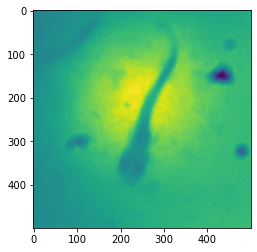

In [40]:
plt.imshow(clip[0,:,:])

In [71]:
clip_to_draw = np.zeros((clip.shape[0],500,500,3))
for i,frame in enumerate(clip):
    bgr = cv2.cvtColor(frame,cv2.COLOR_GRAY2BGR)
    clip_to_draw[i,:,:,:] = bgr

In [72]:
united = np.concatenate([clip_to_draw,255*flow4],axis=2)
united.shape

(100, 500, 1000, 3)

In [74]:
from moviepy.editor import ImageSequenceClip
#flow_gif = ImageSequenceClip(list((clip[:,:,:,np.newaxis]).astype(np.uint8)), fps=20)    
#flow_gif = ImageSequenceClip(list((255*flow4).astype(np.uint8)), fps=20) 
flow_gif = ImageSequenceClip(list(united.astype(np.uint8)), fps=20) 
flow_gif.write_gif('G:/My Drive/PhD/Fishbase/SwimVSFeed/terset.gif', fps=20)

MoviePy - Building file G:/My Drive/PhD/Fishbase/SwimVSFeed/terset.gif with imageio.


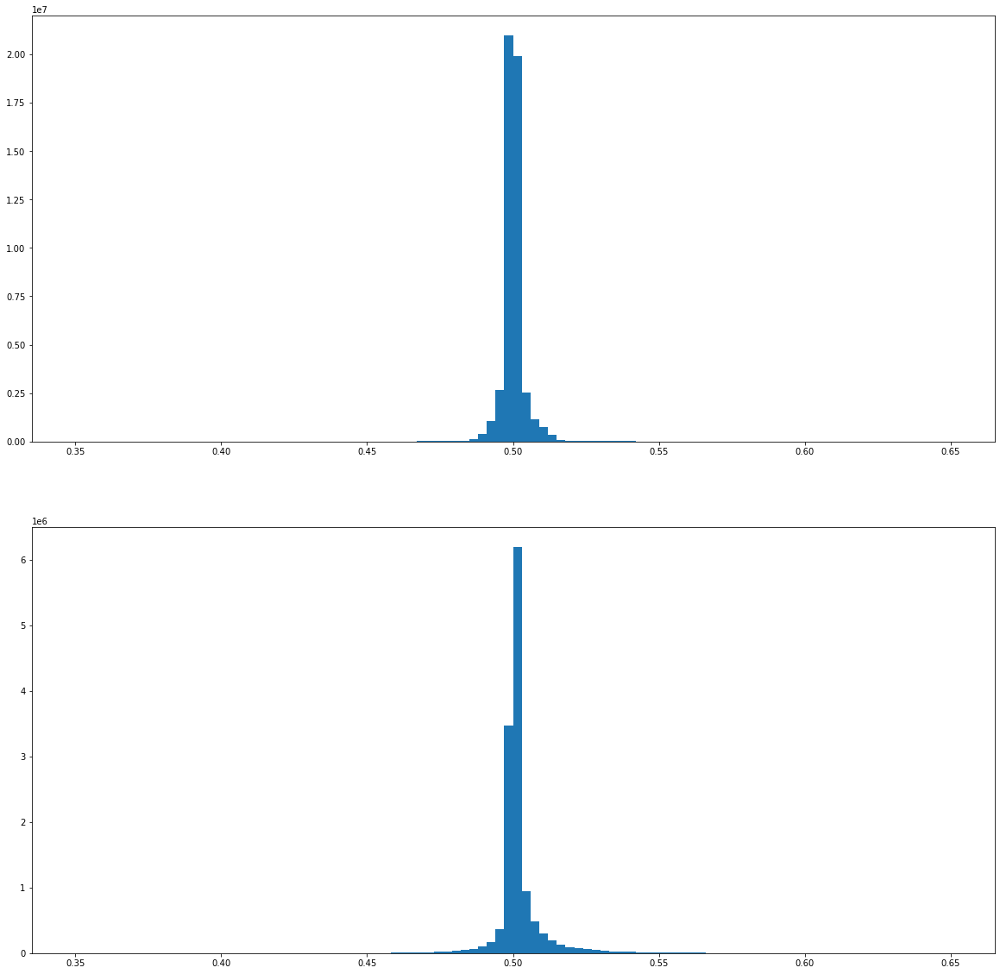

In [48]:
plt.figure(figsize=(20,20))
plt.subplot(2,1,1)
vals3,bins3,_ = plt.hist(flow3[:,:,:,0:2].ravel(),bins=100, range=(0.35,0.65))
plt.subplot(2,1,2)
vals4,bins4,_  = plt.hist(flow4[:,:,:,0:2].ravel(),bins=100,range=(0.35,0.65))

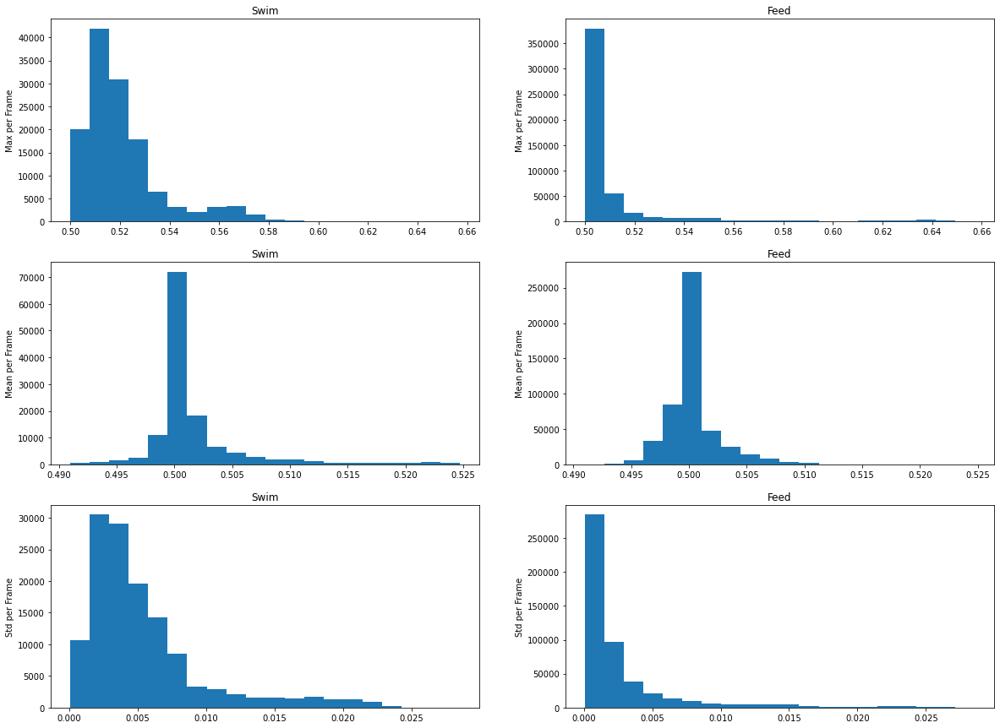

In [108]:
make_histograms(flow4,flow3)

In [107]:
def make_histograms(swim, feed):
    max_swim = swim[:,:,:,0:2].max(axis=0) # max per frame
    max_feed = feed[:,:,:,0:2].max(axis=0) # max per frame
    mean_swim = swim[:,:,:,0:2].mean(axis=0) # mean by frame
    mean_feed = feed[:,:,:,0:2].mean(axis=0) # mean by frame
    std_swim = swim[:,:,:,0:2].std(axis=0) # std by frame
    std_feed = feed[:,:,:,0:2].std(axis=0) # std by frame
    get_lims = lambda arr1,arr2: (min(arr1.min(),arr2.min()),max(arr1.max(),arr2.max()))
    max_lims = get_lims(max_swim,max_feed)
    mean_lims = get_lims(mean_swim,mean_feed)
    std_lims = get_lims(std_swim,std_feed)
    plt.figure(figsize=(20,15))
    plt.subplot(3,2,1)
    plt.title('Swim')
    plt.ylabel('Max per Frame')
    plt.hist(max_swim.ravel(), range=max_lims, bins=20)
    plt.subplot(3,2,2)
    plt.title('Feed')
    plt.hist(max_feed.ravel(), range=max_lims, bins=20)
    plt.ylabel('Max per Frame')
    plt.subplot(3,2,3)
    plt.title('Swim')
    plt.ylabel('Mean per Frame')
    plt.hist(mean_swim.ravel(), range=mean_lims, bins=20)
    plt.subplot(3,2,4)
    plt.title('Feed')
    plt.hist(mean_feed.ravel(), range=mean_lims, bins=20)
    plt.ylabel('Mean per Frame')
    plt.subplot(3,2,5)
    plt.title('Swim')
    plt.ylabel('Std per Frame')
    plt.hist(std_swim.ravel(), range=std_lims, bins=20)
    plt.subplot(3,2,6)
    plt.title('Feed')
    plt.hist(std_feed.ravel(), range=std_lims, bins=20)
    plt.ylabel('Std per Frame')

t:  10%|█         | 10/100 [00:00<00:00, 92.24it/s, now=None]

MoviePy - Building file /Volumes/GoogleDrive/My Drive/PhD/Fishbase/SwimVSFeed/swim2clip.gif with imageio.


In [284]:
cap = cv2.VideoCapture('/Volumes/GoogleDrive/My Drive/PhD/Fishbase/SwimVSFeed/Swim/same orientation/cutoutframe_67230_coords_1388-918_fish0.avi')
ret,fra =cap.read()
fra= cv2.cvtColor(fra,cv2.COLOR_RGB2GRAY)
fra

array([[178, 178, 178, ..., 213, 211, 209],
       [178, 178, 178, ..., 211, 209, 208],
       [178, 178, 178, ..., 209, 208, 207],
       ...,
       [190, 190, 189, ..., 204, 204, 205],
       [189, 189, 189, ..., 205, 206, 206],
       [186, 186, 186, ..., 207, 207, 207]], dtype=uint8)

In [53]:
cap = cv2.VideoCapture('/Volumes/GoogleDrive/My Drive/PhD/Fishbase/SwimVSFeed/old Feed/roi/1 (2).avi')
ret,frame =cap.read()
frame = cv2.cvtColor(frame,cv2.COLOR_RGB2GRAY)
num_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
flow3 = np.zeros([num_frames,
                  int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT)),
                  int(cap.get(cv2.CAP_PROP_FRAME_WIDTH)),
                  3])
clip = np.zeros([num_frames,
                  int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT)),
                  int(cap.get(cv2.CAP_PROP_FRAME_WIDTH)),3])
for i in range(num_frames-1):
    prev = frame.copy()
    ret,frame = cap.read()
    clip[i,:,:,:] = frame
    frame = cv2.cvtColor(frame,cv2.COLOR_RGB2GRAY)
    flow2 = compute_TVL1(prev,frame,bound=40)
    flow3[i,:,:,:-1] = flow2
    

flow3 = (flow3 + 1)/2

In [54]:
united = np.concatenate([clip,255*flow3],axis=2)
united.shape

(101, 500, 1000, 3)

In [55]:
from moviepy.editor import ImageSequenceClip
flow_gif = ImageSequenceClip(list(united.astype(np.uint8)), fps=20)    
flow_gif.write_gif('/Volumes/GoogleDrive/My Drive/PhD/Fishbase/SwimVSFeed/feedunited3.gif', fps=20)

t:   3%|▎         | 3/101 [00:00<00:03, 26.17it/s, now=None]

MoviePy - Building file /Volumes/GoogleDrive/My Drive/PhD/Fishbase/SwimVSFeed/feedunited3.gif with imageio.


In [195]:
im = Image.open('/Volumes/GoogleDrive/My Drive/PhD/Fishbase/SwimVSFeed/v_CricketShot_g04_c01_rgb.gif')

In [208]:
li=[]
for frame in ImageSequence.Iterator(im):
    li.append(np.asarray(frame)[:,:,np.newaxis])

In [209]:
gif=np.concatenate(li,axis=2)

In [14]:
c=cv2.optflow.RLOFOpticalFlowParameter_create()
f= cv2.optflow.SparseRLOFOpticalFlow_create(rlofParam=c)
#frame = cv2.cvtColor(frame,cv2.COLOR_GRAY2BGR)
#ret,frame2 = cap.read()
#frame2 = cv2.cvtColor(frame2,cv2.COLOR_GRAY2BGR)
f.calc(frame,frame2,None)

TypeError: SparseOpticalFlow.calc() missing required argument 'nextPts' (pos 4)

In [7]:
def put_optical_flow_arrows_on_image(image, optical_flow_image, threshold=2.0, skip_amount=30):
    # Don't affect original image
    image = image.copy()
    
    # Turn grayscale to rgb if needed
    if len(image.shape) == 2:
        image = np.stack((image,)*3, axis=2)
    
    # Get start and end coordinates of the optical flow
    flow_start = np.stack(np.meshgrid(range(optical_flow_image.shape[1]), range(optical_flow_image.shape[0])), 2)
    flow_end = (optical_flow_image[flow_start[:,:,1],flow_start[:,:,0],:1]*3 + flow_start).astype(np.int32)
    

    # Threshold values
    norm = np.linalg.norm(flow_end - flow_start, axis=2)
    norm[norm < threshold] = 0
    
    # Draw all the nonzero values
    nz = np.nonzero(norm)
    for i in range(0, len(nz[0]), skip_amount):
        y, x = nz[0][i], nz[1][i]
        cv2.arrowedLine(image,
                        pt1=tuple(flow_start[y,x]), 
                        pt2=tuple(flow_end[y,x]),
                        color=(0, 255, 0), 
                        thickness=1, 
                        tipLength=.2)
    return image
def dense_optical_flow(method, video_path, params=[], to_gray=False):
    cap = cv2.VideoCapture(video_path)
    ret, frame0 = cap.read()
    # create hsv image for the visualization of the optical flow:
    hsv = np.zeros_like(frame0)
    hsv[..., 1] = 255 # saturation is a constant non informative value
    if to_gray:
        frame0 = cv2.cvtColor(frame0, cv2.COLOR_BGR2GRAY)
    while True:
        ret, frame1 = cap.read()
        if not ret:
            break
        if to_gray:
            frame1 = cv2.cvtColor(frame1, cv2.COLOR_BGR2GRAY) 
        flow = method(frame0, frame1, None, *params)
        mag, ang = cv2.cartToPolar(flow[..., 0], flow[..., 1])
        # Use Hue and Value to encode the Optical Flow
        hsv[..., 0] = ang * 180 / np.pi / 2
        hsv[..., 2] = cv2.normalize(mag, None, 0, 255, cv2.NORM_MINMAX)
        bgr = cv2.cvtColor(hsv, cv2.COLOR_HSV2BGR)
        cv2.imshow("frame", put_optical_flow_arrows_on_image(frame1,flow))
        cv2.imshow("optical flow", bgr)
        k = cv2.waitKey(25) & 0xFF
        if k == 27:
            break
        frame0 = frame1.copy()

In [9]:
video_path = '/Volumes/GoogleDrive/My Drive/PhD/Fishbase/SwimVSFeed/old Feed/roi/cutout_frame_664862_fish_0.avi'
method = cv2.optflow.DualTVL1OpticalFlow_create().calc
c=cv2.optflow.RLOFOpticalFlowParameter_create()
frames = dense_optical_flow(method, video_path,to_gray=True)


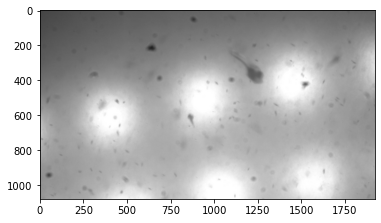

In [34]:
cap = cv2.VideoCapture('/Volumes/GoogleDrive/.shortcut-targets-by-id/1QcQwim7KcScZEja6F7B2sefeCyw_4Sxy/Shir/Fish_10/12.10.20 - frames 1441060-1441520 F.avi')
ret,frame = cap.read()
plt.imshow(frame)

(750, 750, 3)

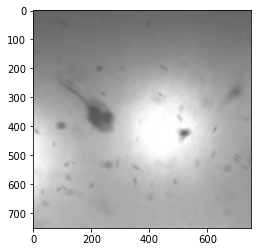

In [35]:
plt.imshow(frame[0:750,1000:1750])
frame[0:750,1000:1750].shape

In [121]:
fourcc=cv2.VideoWriter_fourcc(*'MJPG')
video_writer=cv2.VideoWriter('/Volumes/GoogleDrive/.shortcut-targets-by-id/1QcQwim7KcScZEja6F7B2sefeCyw_4Sxy/Shir/Fish_10/07.10.20  - frames 108155-108410 F.avi',fourcc, 30, (750,750), False)
cap = cv2.VideoCapture('/Volumes/GoogleDrive/.shortcut-targets-by-id/1QcQwim7KcScZEja6F7B2sefeCyw_4Sxy/Shir/Fish_10/07.10.20  - frames 108155-108410 F.avi')
ret,frame = cap.read()
while ret:
    frame_cut = cv2.cvtColor(frame[330:1080,250:1000],cv2.COLOR_BGR2GRAY)
    print(frame_cut.shape)
    video_writer.write(frame_cut)
    #ret,frame = cap.read()
    ret,frame = cap.read()
video_writer.release()
    

(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)
(800, 650)